# Import Libraries

In [1]:
import os
import numpy as np
import pandas as pd

import seaborn as sns
import plotly.express as px 
import matplotlib.pyplot as plt
%matplotlib inline

from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.manifold import TSNE
from sklearn.decomposition import PCA
from sklearn.metrics import euclidean_distances
from scipy.spatial.distance import cdist

import warnings
warnings.filterwarnings("ignore")

# Read Data

In [2]:
data=pd.read_csv("dataset.csv")
data

,Unnamed: 0,track_id,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,...,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,0,5SuOikwiRyPMVoIQDJUgSV,Gen Hoshino,Comedy,Comedy,73,230666,False,0.676,0.4610,...,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.7150,87.917,4,acoustic
1,1,4qPNDBW1i3p13qLCt0Ki3A,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,149610,False,0.420,0.1660,...,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.2670,77.489,4,acoustic
2,2,1iJBSr7s7jYXzM8EGcbK5b,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,210826,False,0.438,0.3590,...,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.1200,76.332,4,acoustic
3,3,6lfxq3CG4xtTiEg7opyCyx,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,201933,False,0.266,0.0596,...,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.1430,181.740,3,acoustic
4,4,5vjLSffimiIP26QG5WcN2K,Chord Overstreet,Hold On,Hold On,82,198853,False,0.618,0.4430,...,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.1670,119.949,4,acoustic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113995,113995,2C3TZjDRiAzdyViavDJ217,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Sleep My Little Boy,21,384999,False,0.172,0.2350,...,-16.393,1,0.0422,0.6400,0.928000,0.0863,0.0339,125.995,5,world-music
113996,113996,1hIz5L4IB9hN3WRYPOCGPw,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Water Into Light,22,385000,False,0.174,0.1170,...,-18.318,0,0.0401,0.9940,0.976000,0.1050,0.0350,85.239,4,world-music
113997,113997,6x8ZfSoqDjuNa5SVP5QjvX,Cesária Evora,Best Of,Miss Perfumado,22,271466,False,0.629,0.3290,...,-10.895,0,0.0420,0.8670,0.000000,0.0839,0.7430,132.378,4,world-music
113998,113998,2e6sXL2bYv4bSz6VTdnfLs,Michael W. Smith,Change Your World,Friends,41,283893,False,0.587,0.5060,...,-10.889,1,0.0297,0.3810,0.000000,0.2700,0.4130,135.960,4,world-music


In [3]:
data.shape

(114000, 21)

In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 114000 entries, 0 to 113999
Data columns (total 21 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Unnamed: 0        114000 non-null  int64  
 1   track_id          114000 non-null  object 
 2   artists           113999 non-null  object 
 3   album_name        113999 non-null  object 
 4   track_name        113999 non-null  object 
 5   popularity        114000 non-null  int64  
 6   duration_ms       114000 non-null  int64  
 7   explicit          114000 non-null  bool   
 8   danceability      114000 non-null  float64
 9   energy            114000 non-null  float64
 10  key               114000 non-null  int64  
 11  loudness          114000 non-null  float64
 12  mode              114000 non-null  int64  
 13  speechiness       114000 non-null  float64
 14  acousticness      114000 non-null  float64
 15  instrumentalness  114000 non-null  float64
 16  liveness          11

In [5]:
data.columns

Index(['Unnamed: 0', 'track_id', 'artists', 'album_name', 'track_name',
       'popularity', 'duration_ms', 'explicit', 'danceability', 'energy',
       'key', 'loudness', 'mode', 'speechiness', 'acousticness',
       'instrumentalness', 'liveness', 'valence', 'tempo', 'time_signature',
       'track_genre'],
      dtype='object')

In [6]:
data1 = data.drop(['Unnamed: 0', 'track_id'], axis=1)
data1

,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,Gen Hoshino,Comedy,Comedy,73,230666,False,0.676,0.4610,1,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.7150,87.917,4,acoustic
1,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,149610,False,0.420,0.1660,1,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.2670,77.489,4,acoustic
2,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,210826,False,0.438,0.3590,0,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.1200,76.332,4,acoustic
3,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,201933,False,0.266,0.0596,0,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.1430,181.740,3,acoustic
4,Chord Overstreet,Hold On,Hold On,82,198853,False,0.618,0.4430,2,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.1670,119.949,4,acoustic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113995,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Sleep My Little Boy,21,384999,False,0.172,0.2350,5,-16.393,1,0.0422,0.6400,0.928000,0.0863,0.0339,125.995,5,world-music
113996,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Water Into Light,22,385000,False,0.174,0.1170,0,-18.318,0,0.0401,0.9940,0.976000,0.1050,0.0350,85.239,4,world-music
113997,Cesária Evora,Best Of,Miss Perfumado,22,271466,False,0.629,0.3290,0,-10.895,0,0.0420,0.8670,0.000000,0.0839,0.7430,132.378,4,world-music
113998,Michael W. Smith,Change Your World,Friends,41,283893,False,0.587,0.5060,7,-10.889,1,0.0297,0.3810,0.000000,0.2700,0.4130,135.960,4,world-music


In [7]:
data1[data1.duplicated()].shape

(577, 19)

In [8]:
data2 = data1.drop_duplicates()
data2

,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
0,Gen Hoshino,Comedy,Comedy,73,230666,False,0.676,0.4610,1,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.7150,87.917,4,acoustic
1,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,149610,False,0.420,0.1660,1,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.2670,77.489,4,acoustic
2,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,210826,False,0.438,0.3590,0,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.1200,76.332,4,acoustic
3,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,201933,False,0.266,0.0596,0,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.1430,181.740,3,acoustic
4,Chord Overstreet,Hold On,Hold On,82,198853,False,0.618,0.4430,2,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.1670,119.949,4,acoustic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113995,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Sleep My Little Boy,21,384999,False,0.172,0.2350,5,-16.393,1,0.0422,0.6400,0.928000,0.0863,0.0339,125.995,5,world-music
113996,Rainy Lullaby,#mindfulness - Soft Rain for Mindful Meditatio...,Water Into Light,22,385000,False,0.174,0.1170,0,-18.318,0,0.0401,0.9940,0.976000,0.1050,0.0350,85.239,4,world-music
113997,Cesária Evora,Best Of,Miss Perfumado,22,271466,False,0.629,0.3290,0,-10.895,0,0.0420,0.8670,0.000000,0.0839,0.7430,132.378,4,world-music
113998,Michael W. Smith,Change Your World,Friends,41,283893,False,0.587,0.5060,7,-10.889,1,0.0297,0.3810,0.000000,0.2700,0.4130,135.960,4,world-music


In [9]:
data2.shape

(113423, 19)

In [10]:
print(data2['track_genre'].unique())

['acoustic' 'afrobeat' 'alt-rock' 'alternative' 'ambient' 'anime'
 'black-metal' 'bluegrass' 'blues' 'brazil' 'breakbeat' 'british'
 'cantopop' 'chicago-house' 'children' 'chill' 'classical' 'club' 'comedy'
 'country' 'dance' 'dancehall' 'death-metal' 'deep-house' 'detroit-techno'
 'disco' 'disney' 'drum-and-bass' 'dub' 'dubstep' 'edm' 'electro'
 'electronic' 'emo' 'folk' 'forro' 'french' 'funk' 'garage' 'german'
 'gospel' 'goth' 'grindcore' 'groove' 'grunge' 'guitar' 'happy'
 'hard-rock' 'hardcore' 'hardstyle' 'heavy-metal' 'hip-hop' 'honky-tonk'
 'house' 'idm' 'indian' 'indie-pop' 'indie' 'industrial' 'iranian'
 'j-dance' 'j-idol' 'j-pop' 'j-rock' 'jazz' 'k-pop' 'kids' 'latin'
 'latino' 'malay' 'mandopop' 'metal' 'metalcore' 'minimal-techno' 'mpb'
 'new-age' 'opera' 'pagode' 'party' 'piano' 'pop-film' 'pop' 'power-pop'
 'progressive-house' 'psych-rock' 'punk-rock' 'punk' 'r-n-b' 'reggae'
 'reggaeton' 'rock-n-roll' 'rock' 'rockabilly' 'romance' 'sad' 'salsa'
 'samba' 'sertanejo' 'show

In [11]:
data2['track_genre'].value_counts().head(30)

track_genre
acoustic             1000
j-rock               1000
electronic           1000
mandopop             1000
reggaeton            1000
sad                  1000
samba                1000
sertanejo            1000
sleep                1000
spanish              1000
ska                  1000
swedish              1000
tango                1000
industrial           1000
techno               1000
pagode               1000
k-pop                 999
dubstep               999
gospel                999
happy                 999
jazz                  999
garage                999
funk                  999
j-idol                999
afrobeat              999
metalcore             999
mpb                   999
indian                999
malay                 999
progressive-house     999
Name: count, dtype: int64

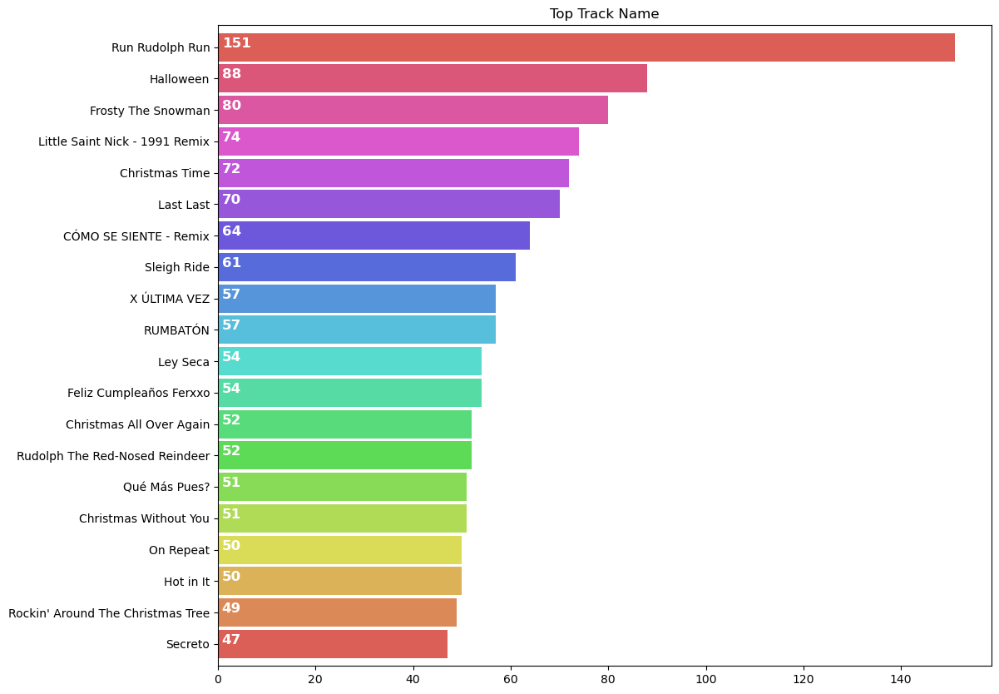

In [12]:
plt.subplots(figsize=(12,10))
a=[]
for i in data2['track_name']:
    a.append(i)
am=pd.Series(a).value_counts()[0:20].sort_values(ascending=True).plot.barh(width=0.9,color=sns.color_palette('hls',19))
for i,v in enumerate(pd.Series(a).value_counts()[0:20].sort_values(ascending=True).values):
     am.text(.8,i,v,fontsize=12,color='white',weight='bold')
plt.title("Top Track Name")
plt.show()

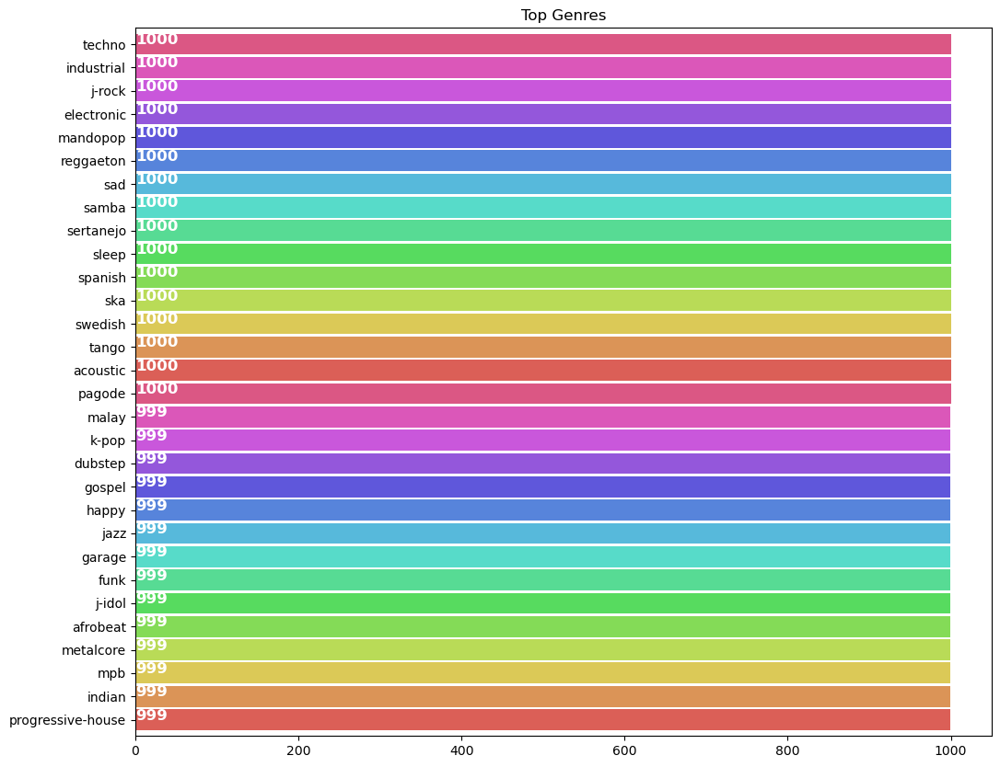

In [13]:
plt.subplots(figsize=(12,10))
a=[]
for i in data2['track_genre']:
    a.append(i)
am=pd.Series(a).value_counts()[0:30].sort_values(ascending=True).plot.barh(width=0.9,color=sns.color_palette('hls',15))
for i,v in enumerate(pd.Series(a).value_counts()[0:30].sort_values(ascending=True).values):
     am.text(.8,i,v,fontsize=12,color='white',weight='bold')
plt.title("Top Genres")
plt.show()

In [14]:
data2['artists'].value_counts()

artists
The Beatles                      279
George Jones                     260
Stevie Wonder                    235
Linkin Park                      224
Ella Fitzgerald                  221
                                ... 
Keanu Silva;Jhn McFly;Marissa      1
Alan Walker;Hans Zimmer            1
Triplo Max                         1
SAINt JHN;Lil Baby                 1
Jesus Culture                      1
Name: count, Length: 31437, dtype: int64

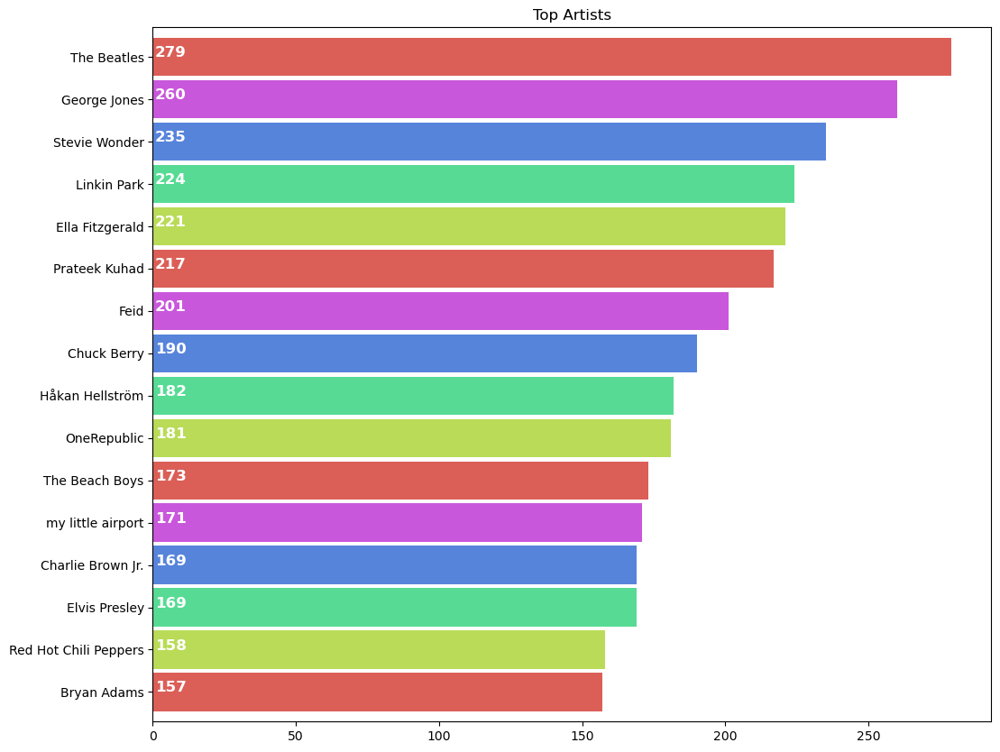

In [15]:
## Top 15 artists name
plt.subplots(figsize=(12,10))
A=[]
for i in data2['artists']:
    A.append(i)
ab=pd.Series(A).value_counts()[0:16].sort_values(ascending=True).plot.barh(width=0.9,color=sns.color_palette('hls',5))
for i,v in enumerate(pd.Series(A).value_counts()[:16].sort_values(ascending=True).values):
    ab.text(.8,i,v,fontsize=12,color='white',weight='bold')
plt.title('Top Artists')
plt.show()

In [16]:
data2[data2['track_genre']=='turkish']

,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
112000,Serhat Durmus,La Câlin,La Câlin,67,172008,False,0.598,0.439,2,-10.987,1,0.0429,0.08790,0.868000,0.1030,0.0673,147.840,4,turkish
112001,Lil Zey;Kozmos,Viral Şarkılar,Eskisi Gibi,0,186461,True,0.802,0.592,1,-7.495,0,0.1200,0.62900,0.005800,0.0900,0.6650,129.899,4,turkish
112002,Serhat Durmus,Gesi Bağları,Gesi Bağları,51,215973,False,0.590,0.460,5,-11.046,0,0.0271,0.03960,0.121000,0.1340,0.0392,100.987,4,turkish
112003,Serhat Durmus;Ecem Telli,Yalan,Yalan,53,201775,False,0.580,0.525,3,-10.873,0,0.0363,0.00695,0.050900,0.0759,0.0925,112.991,4,turkish
112004,Ilkay Sencan,Do It,Do It,52,210146,True,0.795,0.874,1,-3.502,1,0.0506,0.08120,0.090600,0.0650,0.2000,108.001,4,turkish
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
112995,Ebru Yaşar,Haddinden Fazla,Öldüm Sahiden,37,249996,False,0.277,0.674,7,-5.128,0,0.0458,0.22400,0.000000,0.0943,0.3560,85.839,4,turkish
112996,Can Bonomo;Ceza,Kâinat Sustu,Terslik Var,37,200776,False,0.676,0.799,7,-6.933,0,0.0412,0.08970,0.000000,0.1330,0.5680,98.018,4,turkish
112997,Melike Şahin,Merhem: İlk Konserler (Live),Uykumun Boynunu Bükme (Live @ Bostancı Gösteri...,37,280469,False,0.488,0.672,9,-11.690,0,0.0365,0.02190,0.000035,0.7120,0.4630,105.943,3,turkish
112998,Hayko Cepkin,Aşkın Izdırabını,Geç Kaldım - Akustik,37,206680,False,0.425,0.405,7,-12.428,0,0.0299,0.33300,0.000025,0.1360,0.3820,160.058,3,turkish


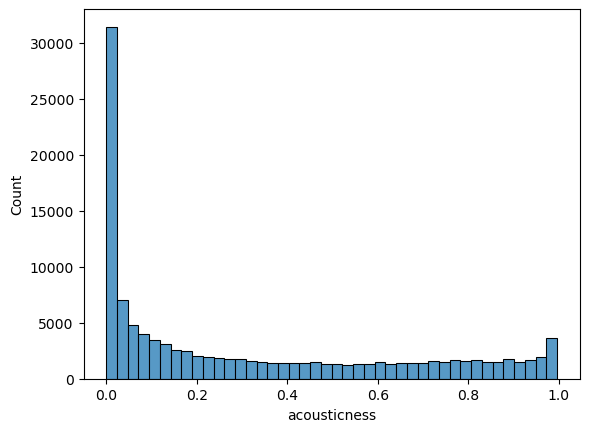

In [17]:
sns.histplot(data=data2, x="acousticness")
plt.show()

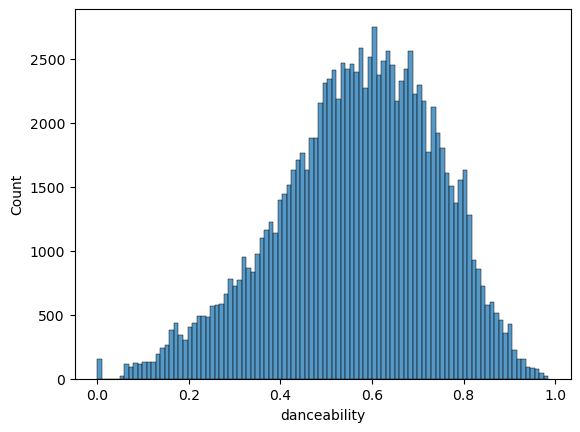

In [18]:
sns.histplot(data=data2, x="danceability")
plt.show()

In [19]:
data2.isna().sum()

artists             1
album_name          1
track_name          1
popularity          0
duration_ms         0
explicit            0
danceability        0
energy              0
key                 0
loudness            0
mode                0
speechiness         0
acousticness        0
instrumentalness    0
liveness            0
valence             0
tempo               0
time_signature      0
track_genre         0
dtype: int64

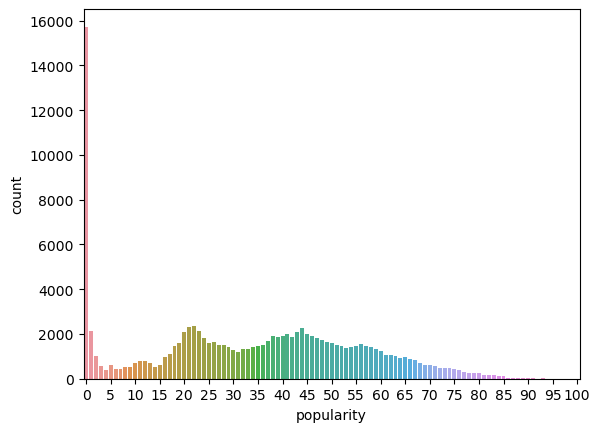

In [20]:
sns.countplot(data=data2, x='popularity')
plt.xticks(range(0, 101, 5))
plt.show()

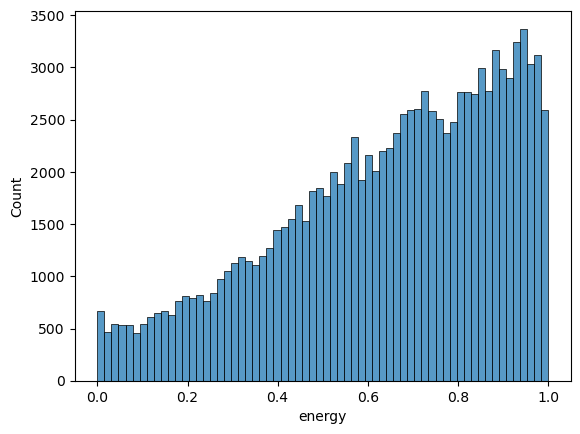

In [21]:
sns.histplot(data=data2, x="energy")
plt.show()

In [22]:
data2.describe()

,popularity,duration_ms,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature
count,113423.000000,1.134230e+05,113423.000000,113423.000000,113423.000000,113423.000000,113423.000000,113423.000000,113423.000000,113423.000000,113423.000000,113423.000000,113423.000000,113423.000000
mean,33.359380,2.280991e+05,0.567112,0.642174,5.309346,-8.242924,0.637675,0.084697,0.314078,0.155800,0.213609,0.474241,122.176324,3.904226
std,22.269748,1.064525e+05,0.173402,0.251030,3.559755,5.011910,0.480674,0.105802,0.331944,0.309313,0.190481,0.259239,29.972010,0.432075
min,0.000000,0.000000e+00,0.000000,0.000000,0.000000,-49.531000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,17.000000,1.741655e+05,0.456000,0.473000,2.000000,-9.998000,0.000000,0.035900,0.016800,0.000000,0.098000,0.260000,99.299000,4.000000
50%,35.000000,2.130160e+05,0.580000,0.685000,5.000000,-6.996000,1.000000,0.048900,0.168000,0.000041,0.132000,0.464000,122.019000,4.000000
75%,50.000000,2.616000e+05,0.695000,0.854000,8.000000,-5.001000,1.000000,0.084550,0.596000,0.048700,0.273000,0.683000,140.073000,4.000000
max,100.000000,5.237295e+06,0.985000,1.000000,11.000000,4.532000,1.000000,0.965000,0.996000,1.000000,1.000000,0.995000,243.372000,5.000000


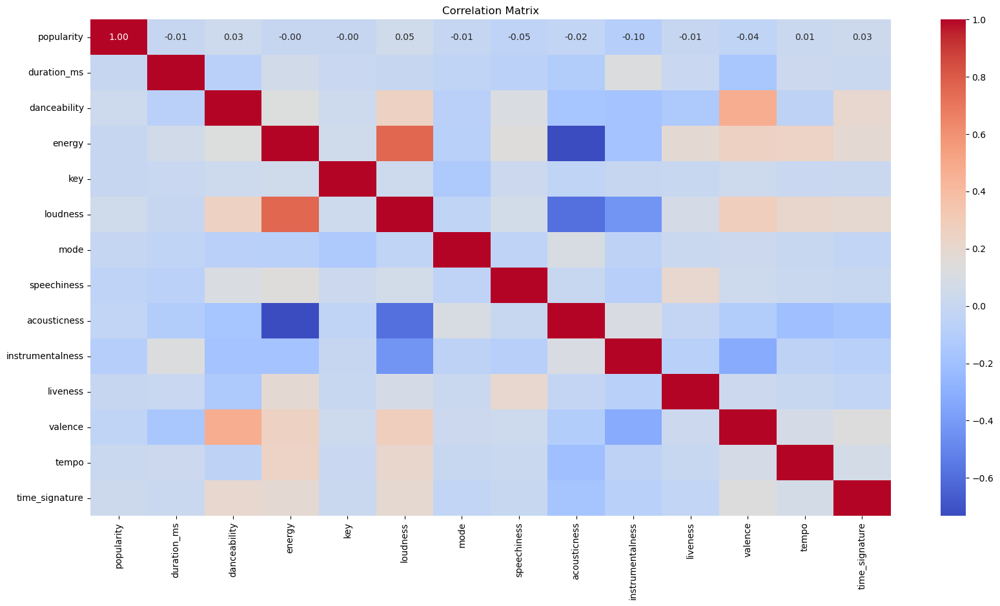

In [23]:
numeric_data = data2.select_dtypes(include=['int', 'float'])

corr_matrix = numeric_data.corr()
plt.figure(figsize=(20,10))
sns.heatmap(corr_matrix, cmap='coolwarm', annot=True,fmt=".2f")
plt.title('Correlation Matrix')
plt.show()

In [24]:
data2.isnull().sum()

artists             1
album_name          1
track_name          1
popularity          0
duration_ms         0
explicit            0
danceability        0
energy              0
key                 0
loudness            0
mode                0
speechiness         0
acousticness        0
instrumentalness    0
liveness            0
valence             0
tempo               0
time_signature      0
track_genre         0
dtype: int64

In [25]:
data2[data2.isnull().any(axis=1)]

,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre
65900,NaN,NaN,NaN,0,0,False,0.501,0.583,7,-9.46,0,0.0605,0.69,0.00396,0.0747,0.734,138.391,4,k-pop


In [26]:
data2['popularity'].mean()

33.35938037258757

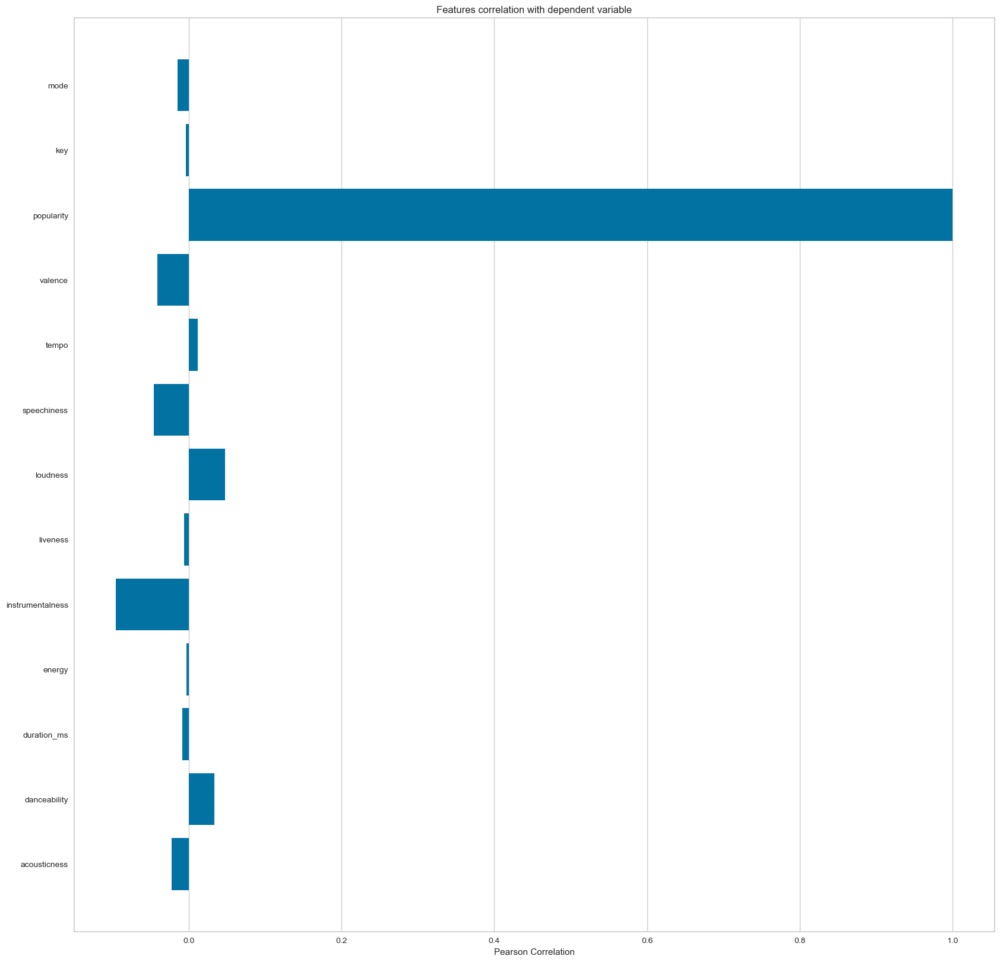

<Axes: title={'center': 'Features correlation with dependent variable'}, xlabel='Pearson Correlation'>

In [27]:
from yellowbrick.target import FeatureCorrelation

feature_names = ['acousticness', 'danceability', 'duration_ms', 'energy',
       'instrumentalness', 'liveness', 'loudness', 'speechiness', 'tempo','valence','popularity','key','mode']

X, y = data2[feature_names], data2['popularity']

# Create a list of the feature names
features = np.array(feature_names)

# Instantiate the visualizer
visualizer = FeatureCorrelation(labels=features)

plt.rcParams['figure.figsize']=(20,20)
visualizer.fit(X, y)     # Fit the data to the visualizer
visualizer.show()

# Clustering Songs with K-Means

In [28]:
song_cluster_pipeline = Pipeline([('scaler', StandardScaler()), 
                                  ('kmeans', KMeans(n_clusters=20, 
                                   verbose=False,))
                                 ], verbose=False)

X = data.select_dtypes(np.number)
number_cols = list(X.columns)
song_cluster_pipeline.fit(X)
song_cluster_labels = song_cluster_pipeline.predict(X)
data['cluster_label'] = song_cluster_labels

In [29]:
# Visualizing the Clusters with PCA

from sklearn.decomposition import PCA

pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
song_embedding = pca_pipeline.fit_transform(X)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['title'] = data['popularity']
projection['cluster'] = data['cluster_label']

fig = px.scatter(
    projection, x='x', y='y', color='cluster', hover_data=['x', 'y', 'title'])
fig.show()

# Model Building

In [30]:
data2['tags'] = data2['artists'] + " - " + data2['track_name'] + " - " + data2['track_genre']

In [31]:
data2.head()

,artists,album_name,track_name,popularity,duration_ms,explicit,danceability,energy,key,loudness,mode,speechiness,acousticness,instrumentalness,liveness,valence,tempo,time_signature,track_genre,tags
0,Gen Hoshino,Comedy,Comedy,73,230666,False,0.676,0.4610,1,-6.746,0,0.1430,0.0322,0.000001,0.3580,0.715,87.917,4,acoustic,Gen Hoshino - Comedy - acoustic
1,Ben Woodward,Ghost (Acoustic),Ghost - Acoustic,55,149610,False,0.420,0.1660,1,-17.235,1,0.0763,0.9240,0.000006,0.1010,0.267,77.489,4,acoustic,Ben Woodward - Ghost - Acoustic - acoustic
2,Ingrid Michaelson;ZAYN,To Begin Again,To Begin Again,57,210826,False,0.438,0.3590,0,-9.734,1,0.0557,0.2100,0.000000,0.1170,0.120,76.332,4,acoustic,Ingrid Michaelson;ZAYN - To Begin Again - acou...
3,Kina Grannis,Crazy Rich Asians (Original Motion Picture Sou...,Can't Help Falling In Love,71,201933,False,0.266,0.0596,0,-18.515,1,0.0363,0.9050,0.000071,0.1320,0.143,181.740,3,acoustic,Kina Grannis - Can't Help Falling In Love - ac...
4,Chord Overstreet,Hold On,Hold On,82,198853,False,0.618,0.4430,2,-9.681,1,0.0526,0.4690,0.000000,0.0829,0.167,119.949,4,acoustic,Chord Overstreet - Hold On - acoustic


In [32]:
new_data = data2[['album_name','tags','popularity']]
new_data

,album_name,tags,popularity
0,Comedy,Gen Hoshino - Comedy - acoustic,73
1,Ghost (Acoustic),Ben Woodward - Ghost - Acoustic - acoustic,55
2,To Begin Again,Ingrid Michaelson;ZAYN - To Begin Again - acou...,57
3,Crazy Rich Asians (Original Motion Picture Sou...,Kina Grannis - Can't Help Falling In Love - ac...,71
4,Hold On,Chord Overstreet - Hold On - acoustic,82
...,...,...,...
113995,#mindfulness - Soft Rain for Mindful Meditatio...,Rainy Lullaby - Sleep My Little Boy - world-music,21
113996,#mindfulness - Soft Rain for Mindful Meditatio...,Rainy Lullaby - Water Into Light - world-music,22
113997,Best Of,Cesária Evora - Miss Perfumado - world-music,22
113998,Change Your World,Michael W. Smith - Friends - world-music,41


In [33]:
song_library = new_data.sort_values(by=['popularity'], ascending=False).head(10000)

In [34]:
song_library.reset_index(inplace=True, drop=True)
song_library

,album_name,tags,popularity
0,Unholy (feat. Kim Petras),Sam Smith;Kim Petras - Unholy (feat. Kim Petra...,100
1,Unholy (feat. Kim Petras),Sam Smith;Kim Petras - Unholy (feat. Kim Petra...,100
2,"Quevedo: Bzrp Music Sessions, Vol. 52",Bizarrap;Quevedo - Quevedo: Bzrp Music Session...,99
3,I'm Good (Blue),David Guetta;Bebe Rexha - I'm Good (Blue) - edm,98
4,La Bachata,Manuel Turizo - La Bachata - latin,98
...,...,...,...
9995,Risqué,CHIC - Good Times - disco,64
9996,Hopes And Fears,Keane - This Is The Last Time - piano,64
9997,O Sajna,Neha Kakkar;Tanishk Bagchi;Jaani - O Sajna - p...,64
9998,Shang-Chi and The Legend of The Ten Rings: The...,keshi - War With Heaven - chill,64


In [35]:
from sklearn.feature_extraction.text import CountVectorizer
cv = CountVectorizer(max_features=200,stop_words='english')

In [36]:
vectors = cv.fit_transform(song_library['tags']).toarray()
vectors[0]

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0], dtype=int64)

In [37]:
song_library['tags'][0]

'Sam Smith;Kim Petras - Unholy (feat. Kim Petras) - dance'

In [38]:
from sklearn.metrics.pairwise import cosine_similarity
similarity = cosine_similarity(vectors)
similarity

array([[1. , 0.5, 0. , ..., 0. , 0. , 0. ],
       [0.5, 1. , 0. , ..., 0.5, 0. , 0. ],
       [0. , 0. , 1. , ..., 0. , 0. , 0. ],
       ...,
       [0. , 0.5, 0. , ..., 1. , 0. , 0. ],
       [0. , 0. , 0. , ..., 0. , 1. , 0. ],
       [0. , 0. , 0. , ..., 0. , 0. , 1. ]])

In [39]:
sorted(similarity[0],reverse=True)

[0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.9999999999999998,
 0.816496580927726,
 0.816496580927726,
 0.816496580927726,
 0.816496580927726,
 0.816496580927726,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.7071067811865475,
 0.707106781186547

In [40]:
list(enumerate(similarity[0]))

[(0, 0.9999999999999998),
 (1, 0.4999999999999999),
 (2, 0.0),
 (3, 0.0),
 (4, 0.0),
 (5, 0.3162277660168379),
 (6, 0.0),
 (7, 0.0),
 (8, 0.0),
 (9, 0.0),
 (10, 0.0),
 (11, 0.0),
 (12, 0.0),
 (13, 0.0),
 (14, 0.0),
 (15, 0.0),
 (16, 0.0),
 (17, 0.0),
 (18, 0.0),
 (19, 0.0),
 (20, 0.408248290463863),
 (21, 0.0),
 (22, 0.0),
 (23, 0.0),
 (24, 0.0),
 (25, 0.0),
 (26, 0.0),
 (27, 0.0),
 (28, 0.0),
 (29, 0.0),
 (30, 0.0),
 (31, 0.0),
 (32, 0.0),
 (33, 0.0),
 (34, 0.0),
 (35, 0.0),
 (36, 0.0),
 (37, 0.0),
 (38, 0.0),
 (39, 0.0),
 (40, 0.0),
 (41, 0.0),
 (42, 0.0),
 (43, 0.0),
 (44, 0.7071067811865475),
 (45, 0.0),
 (46, 0.0),
 (47, 0.0),
 (48, 0.0),
 (49, 0.4999999999999999),
 (50, 0.4999999999999999),
 (51, 0.0),
 (52, 0.0),
 (53, 0.0),
 (54, 0.24999999999999994),
 (55, 0.0),
 (56, 0.0),
 (57, 0.0),
 (58, 0.0),
 (59, 0.0),
 (60, 0.0),
 (61, 0.0),
 (62, 0.0),
 (63, 0.0),
 (64, 0.408248290463863),
 (65, 0.0),
 (66, 0.0),
 (67, 0.0),
 (68, 0.0),
 (69, 0.0),
 (70, 0.0),
 (71, 0.0),
 (72, 0.0),


In [41]:
sorted(list(enumerate(similarity[0])),reverse=True,key=lambda x:x[1])[1:6]

[(170, 0.9999999999999998),
 (525, 0.9999999999999998),
 (739, 0.9999999999999998),
 (784, 0.9999999999999998),
 (785, 0.9999999999999998)]

In [42]:
def recommend(song):
    song_index = song_library[song_library['album_name'] == song].index[0]
    distances = similarity[song_index]
    song_list = sorted(list(enumerate(distances)),reverse=True,key=lambda x:x[1])[1:6]
    
    for i in song_list:
        print(song_library.iloc[i[0]].tags)

In [43]:
recommend('I Love You.')

The Neighbourhood - Softcore - alt-rock
The Neighbourhood - Reflections - alt-rock
The Neighbourhood - The Beach - alt-rock
The Neighbourhood - Afraid - alt-rock
The Neighbourhood - Stargazing - alt-rock


# Deployment

In [44]:
import pickle
pickle.dump(song_library,open('music.pkl','wb'))
pickle.dump(song_library.to_dict(),open('music_dict.pkl','wb'))
pickle.dump(similarity,open('music_similarity.pkl','wb'))